## Vehicle Detection Project

The goals / steps of this project are the following:

- Perform a Histogram of Oriented Gradients (HOG) feature extraction on a labeled training set of images and train a classifier to detect cars/not-cars
- Explore applying a color transform and append binned color features, as well as histograms of color, along with HOG feature vector
- Implement a sliding-window technique and use trained classifier to search for vehicles in images
- Run pipeline on a video stream and create a heat map of recurring detections frame by frame to reject outliers and follow detected vehicles.
- Estimate a bounding box for vehicles detected.


### Code:
- featurizer.py : code for generating color features (spatial binning, color histogram) and shape features (Histogram of Gradients HOG)
- classifier_trainer.py : code to read labeled images, extract features and train a LinearSVM classifier
- config.py : contains parameter values for features
- window_search.py : sliding window implementation to search for cars in image
- detection_pipeline.py : code to build heat map from sliding window detections. Handling false positives.
- image_utils.py : code to draw bounding boxes on image and related
- plot_utils.py : helper code to plot images
- explore_color_spaces.py : debugging code to explore different color transformation schemes

### Outputs:
- test_video_output.mp4 : result of applying my detection pipeline to smaller test video
- project_video_output.mp4 : applying detection pipeline on the larger project video



In [5]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

import pickle
import glob
import cv2

from plot_utils import grid_plot
from detection_pipeline import detect_vehicles
from sklearn.utils import resample

% matplotlib inline

### Exploring data

I am using GTI and KITTI labeled data. Data is separated into 2 directories (cars and not-cars).

Here are some sample examples of data. You can see the total count of cars labeled and not-cars labeled.

num vehicle images : 9312
num non vehicle images : 9748
image shape:  (64, 64, 3)


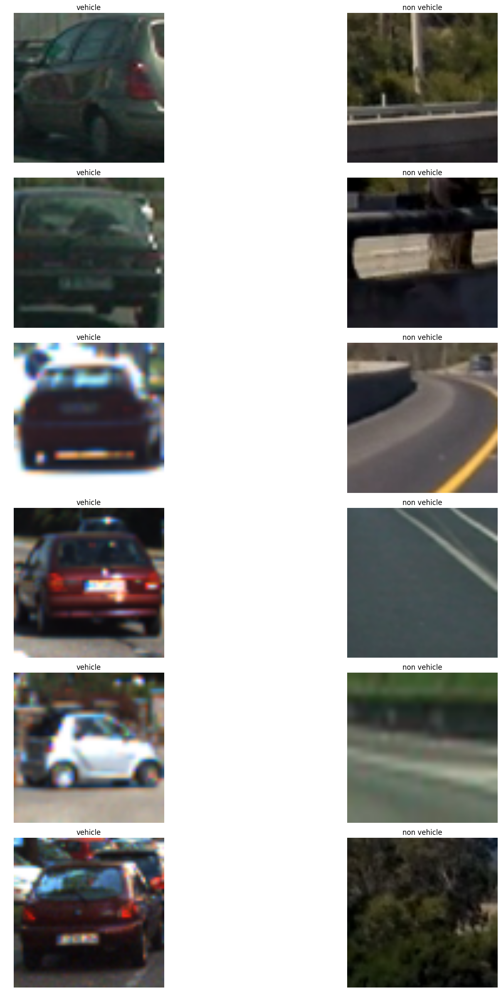

In [7]:
vehicle_paths = glob.glob('data/vehicles/*/*.png')
non_vehicle_paths = glob.glob('data/non-vehicles/*/*.png')

print("num vehicle images : %d"%len(vehicle_paths))
print("num non vehicle images : %d"%len(non_vehicle_paths))

vehicle_sample_images = [mpimg.imread(path) for path in 
                         resample(vehicle_paths, n_samples=6, random_state=0)]
non_vehicle_sample_images = [mpimg.imread(path) for path in 
                             resample(non_vehicle_paths, n_samples=6, random_state=0)]

print("image shape: ", vehicle_sample_images[0].shape)

grid_plot( [("vehicle", vehicle_sample_images),
           ("non vehicle", non_vehicle_sample_images)])

### Exploring color space transformation

Looking at sample images, our training data contains vehicles and non-vehicles in different light conditions. Before applying HOG transformation, I am exploring different color transformation schemes to see if a particular channel separates out vehicle outlines from background.

#### HSV transform

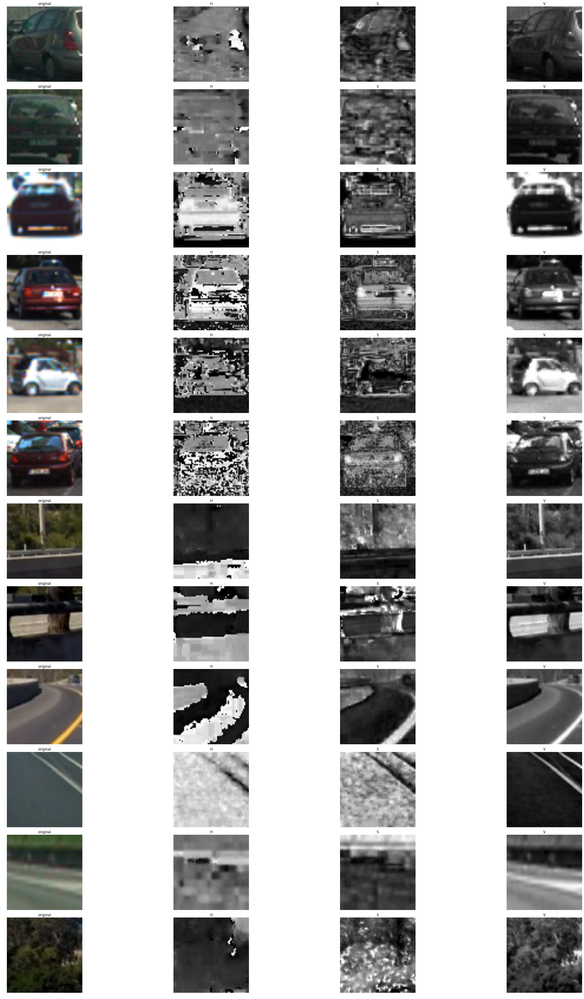

In [8]:
from explore_color_spaces import *
samples = vehicle_sample_images + non_vehicle_sample_images

show_hsv_images(samples)

#### HLS transform:

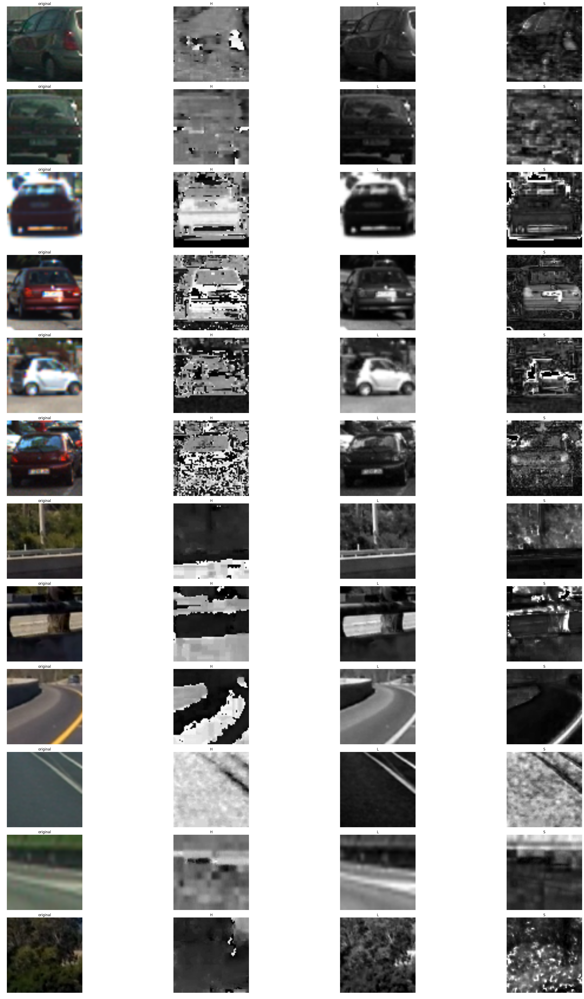

In [9]:
show_hls_images(samples)

#### YCrCb transform:

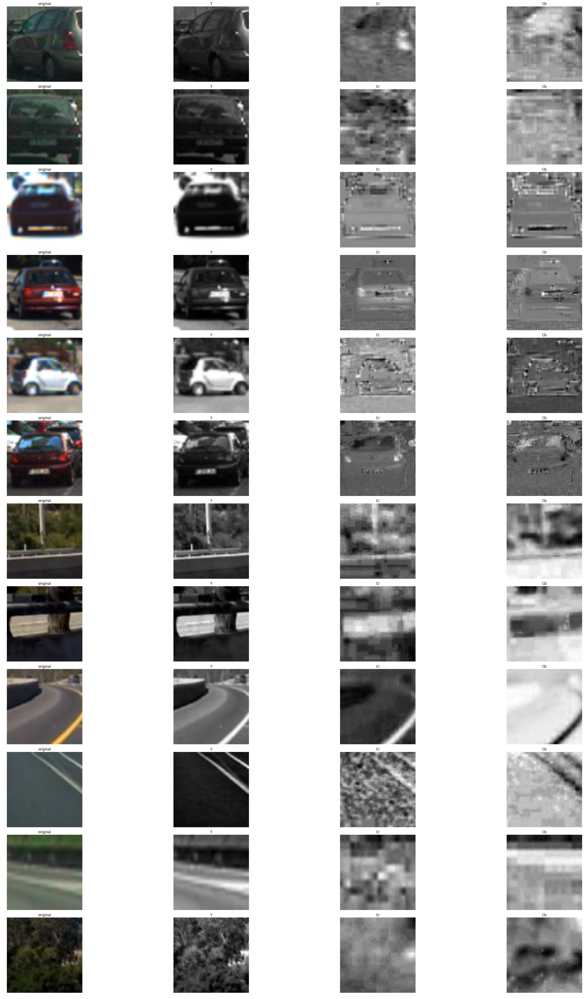

In [10]:
show_ycrcb_images(samples)

Looking at the above images, using S channel in HSV transformation seems to highlight cars well.

Using Cb channel in YCrCb transfomration also looks like a good alternative.

##### I chose YCrCb color transformation since I was getter better performance in car detection with this transformation

### Color features:

I explored 2 features that encode color information in image.

#### Spatial binning of color:
The images we are using for training are 64x64x3. Encoding the color values for each pixel will blow up feature space. Instead, we can reduce resolution of image to 16x16 or 32x32 and use color values. This will reduce feature space significantly.

Here is a comparison of car image down sampled to 64x64 and 32x32 respectively.
We can see that even at 32x32, car is clearly visible to human eye, which means relevant features are still preserved at this resoultion

<img src="report/spatial_binning.png" style="width: 600px;"/>



#### Histograms of color:
We have three channels in an image (RGB/HLS/HSV/YCrCb).
One important feature is to see the spread of color channel values for each of the three channels.

For a RGB image, color histogram can be computed like this:

```
# Take histograms in R, G, and B
rhist = np.histogram(image[:,:,0], bins=32)
ghist = np.histogram(image[:,:,1], bins=32)
bhist = np.histogram(image[:,:,2], bins=32)
```

<img src="report/color_histogram.png" style="width: 700px;"/>
Histogram values (y-axis) for all the three channels can be appended together to form a color histogram feature vector

#### Exploring parameters for color features:
I explored accuracy of a simple linear SVM classifier by varying the parameters for color based features.

Parameter for spatial binning is the size of result image. I am representing this as field named 'spatial;.

Parameter for histograms of color is the number of bins in color histogram. I am representing this as field named 'histbins'

Here is how each of these features influences accuracy:

<img src="report/spatial_hist_table.png" style="width: 200px;"/>

##### Sweet spot seems to be spatial binning of (16x16) with 32 color histograms bins 



### Histogram of Gradients (HOG):


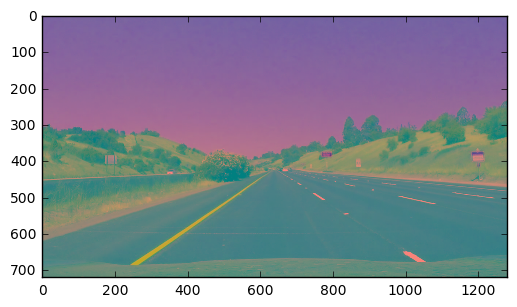

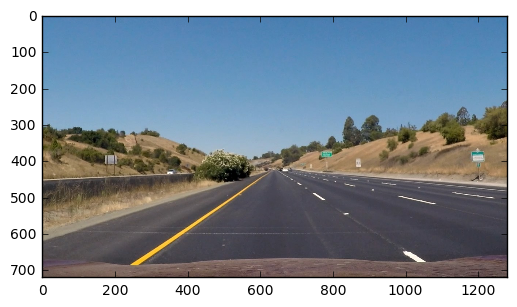

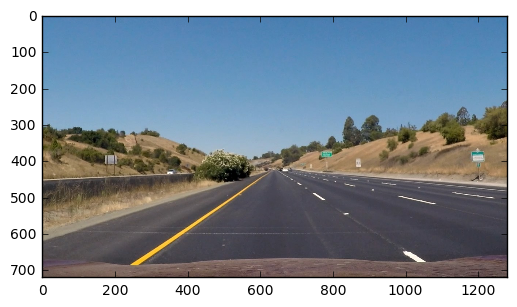

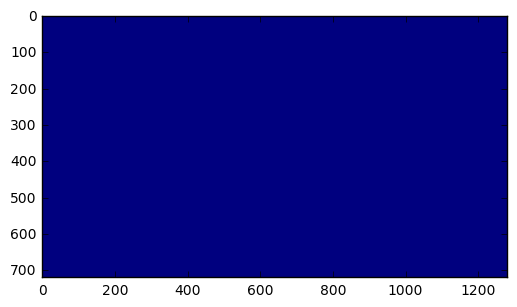

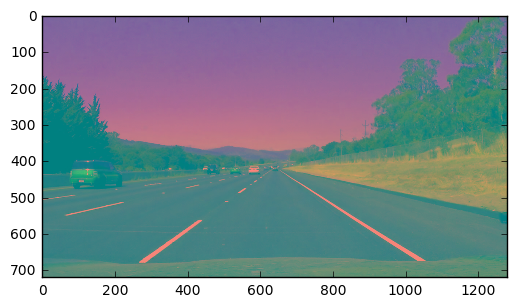

...

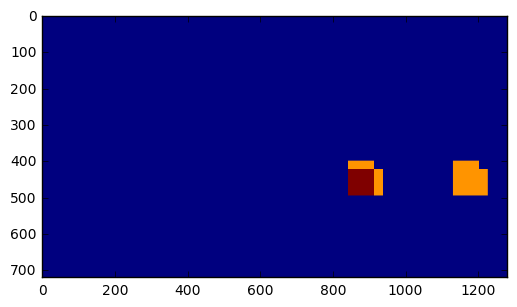

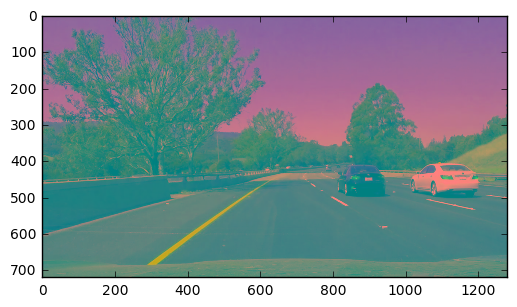

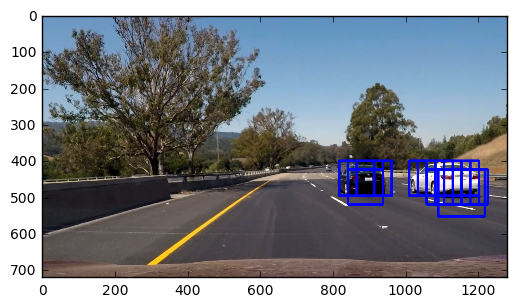

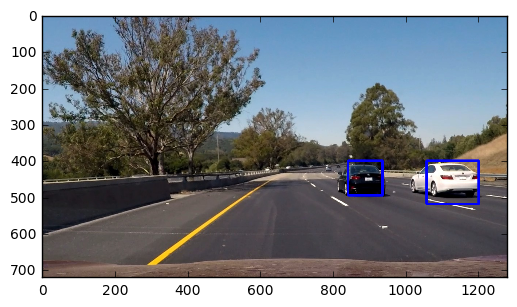

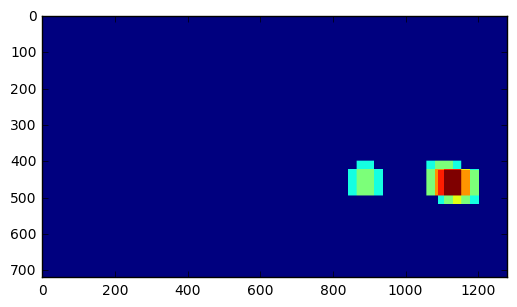

In [2]:
X_scaler = pickle.load(open("scalar.pkl", "rb"))
svm = pickle.load(open("svm.pkl", "rb"))

images = glob.glob("test_images/*")
for file in images:
    image = mpimg.imread(file)
    feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
    plt.imshow(feature_image)
    plt.show()
    window_img, heatmap = detect_vehicles(image, svm, X_scaler, debug=True)
    plt.imshow(window_img)
    plt.show()
    plt.imshow(heatmap)
    plt.show()